# RoadSense - Advanced Predictive Modeling for Traffic Safety

### Submitted by: 
    1. Pranav Harish Sharma 
    2. Harvineet Singh 
    
### Guidance of: 
    - Prof. Zhenyuan Lu - Northeastern Univeristy


## Data Source: 
    The data used is an open-source dataset from Kaggle for our project analysis. This dataset encompasses accident records across 49 states in the USA, spanning from February 2016 to March 2023. The data were collected via various APIs that stream traffic incident information from multiple sources, including the US and state departments of transportation, law enforcement agencies, traffic cameras, and road sensors. The dataset includes approximately 7.7 million accident records. For more details, you can access the dataset here: 
    
    
### Kaggle : https://www.kaggle.com/datasets/sobhanmoosavi/us-accidents?resource=download

### Citations: 

1. Moosavi, Sobhan, Mohammad Hossein Samavatian, Srinivasan Parthasarathy, and Rajiv Ramnath. “A Countrywide Traffic Accident Dataset.”, 2019.

2. Moosavi, Sobhan, Mohammad Hossein Samavatian, Srinivasan Parthasarathy, Radu Teodorescu, and Rajiv Ramnath. "Accident Risk Prediction based on Heterogeneous Sparse Data: New Dataset and Insights." In proceedings of the 27th ACM SIGSPATIAL International Conference on Advances in Geographic Information Systems, ACM, 2019.

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')


In [2]:
df = pd.read_csv('500US Accidents.csv')
df.head()

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-2047758,Source2,2,2019-06-12 10:10:56,2019-06-12 10:55:58,30.641211,-91.153481,NaN,NaN,0.000,...,False,False,False,False,True,False,Day,Day,Day,Day
1,A-4694324,Source1,2,2022-12-03 23:37:14.000000000,2022-12-04 01:56:53.000000000,38.990562,-77.399070,38.990037,-77.398282,0.056,...,False,False,False,False,False,False,Night,Night,Night,Night
2,A-5006183,Source1,2,2022-08-20 13:13:00.000000000,2022-08-20 15:22:45.000000000,34.661189,-120.492822,34.661189,-120.492442,0.022,...,False,False,False,False,True,False,Day,Day,Day,Day
3,A-4237356,Source1,2,2022-02-21 17:43:04,2022-02-21 19:43:23,43.680592,-92.993317,43.680574,-92.972223,1.054,...,False,False,False,False,False,False,Day,Day,Day,Day
4,A-6690583,Source1,2,2020-12-04 01:46:00,2020-12-04 04:13:09,35.395484,-118.985176,35.395476,-118.985995,0.046,...,False,False,False,False,False,False,Night,Night,Night,Night


In [3]:
df.shape

(500000, 46)

In [5]:
df.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,500000.000000,500000.000000,500000.000000,279623.000000,279623.000000,500000.000000,489534.000000,370983.000000,488870.000000,491072.000000,488709.000000,463013.000000,357384.000000
mean,2.212748,36.206421,-94.736583,36.273192,-95.776553,0.564317,61.646254,58.229028,64.834921,29.536621,9.091540,7.681347,0.008289
std,0.486661,5.071411,17.405761,5.265333,18.120211,1.774872,19.000133,22.352246,22.826158,1.008666,2.708083,5.431361,0.101865
min,1.000000,24.562117,-124.497420,24.570110,-124.497419,0.000000,-77.800000,-53.200000,1.000000,0.120000,0.000000,0.000000,0.000000
25%,2.000000,33.416823,-117.233047,33.474773,-117.778324,0.000000,49.000000,43.000000,48.000000,29.370000,10.000000,4.600000,0.000000
50%,2.000000,35.832147,-87.794365,36.192669,-88.039013,0.029000,64.000000,62.000000,67.000000,29.860000,10.000000,7.000000,0.000000
75%,2.000000,40.082443,-80.359601,40.181341,-80.252449,0.465000,76.000000,75.000000,84.000000,30.030000,10.000000,10.400000,0.000000
max,4.000000,48.999569,-67.484130,48.998901,-67.484130,193.479996,207.000000,207.000000,100.000000,38.440000,130.000000,822.800000,10.130000


## Data Cleaning 

### 1. Handling Null Values 

In [6]:
#Showing All the Missing Values 

missing_values = df.isnull().sum().sort_values(ascending=False)
print(missing_values)

End_Lat                  220377
End_Lng                  220377
Precipitation(in)        142616
Wind_Chill(F)            129017
Wind_Speed(mph)           36987
Visibility(mi)            11291
Wind_Direction            11197
Humidity(%)               11130
Weather_Condition         11101
Temperature(F)            10466
Pressure(in)               8928
Weather_Timestamp          7674
Nautical_Twilight          1483
Civil_Twilight             1483
Sunrise_Sunset             1483
Astronomical_Twilight      1483
Airport_Code               1446
Street                      691
Timezone                    507
Zipcode                     116
City                         19
Description                   1
Traffic_Signal                0
Roundabout                    0
Station                       0
Stop                          0
Traffic_Calming               0
Country                       0
Turning_Loop                  0
No_Exit                       0
End_Time                      0
Start_Ti

In [7]:
#Filling Up All the Missing values

df['End_Lat'].fillna(df['End_Lat'].median(), inplace=True)
df['End_Lng'].fillna(df['End_Lng'].median(), inplace=True)
df['Description'].fillna('No Description', inplace=True)
df['Street'].fillna('Unknown', inplace=True)
df['City'].fillna('Unknown', inplace=True)
df['Zipcode'].fillna('Unknown', inplace=True)
df['Timezone'].fillna('Unknown', inplace=True)
df['Airport_Code'].fillna('Unknown', inplace=True)
df['Weather_Timestamp'].fillna('Unknown', inplace=True)
df['Temperature(F)'].fillna(df['Temperature(F)'].median(), inplace=True)
df['Wind_Chill(F)'].fillna(df['Wind_Chill(F)'].median(), inplace=True)
df['Humidity(%)'].fillna(df['Humidity(%)'].median(), inplace=True)
df['Pressure(in)'].fillna(df['Pressure(in)'].median(), inplace=True)
df['Visibility(mi)'].fillna(df['Visibility(mi)'].median(), inplace=True)
df['Wind_Direction'].fillna('Unknown', inplace=True)
df['Wind_Speed(mph)'].fillna(df['Wind_Speed(mph)'].median(), inplace=True)
df['Precipitation(in)'].fillna(0, inplace=True)
df['Weather_Condition'].fillna('Unknown', inplace=True)
df['Timezone'] = df['Timezone'].str.replace('US/', '')



df.head(20)

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-2047758,Source2,2,2019-06-12 10:10:56,2019-06-12 10:55:58,30.641211,-91.153481,36.192669,-88.039013,0.000,...,False,False,False,False,True,False,Day,Day,Day,Day
1,A-4694324,Source1,2,2022-12-03 23:37:14.000000000,2022-12-04 01:56:53.000000000,38.990562,-77.399070,38.990037,-77.398282,0.056,...,False,False,False,False,False,False,Night,Night,Night,Night
2,A-5006183,Source1,2,2022-08-20 13:13:00.000000000,2022-08-20 15:22:45.000000000,34.661189,-120.492822,34.661189,-120.492442,0.022,...,False,False,False,False,True,False,Day,Day,Day,Day
3,A-4237356,Source1,2,2022-02-21 17:43:04,2022-02-21 19:43:23,43.680592,-92.993317,43.680574,-92.972223,1.054,...,False,False,False,False,False,False,Day,Day,Day,Day
4,A-6690583,Source1,2,2020-12-04 01:46:00,2020-12-04 04:13:09,35.395484,-118.985176,35.395476,-118.985995,0.046,...,False,False,False,False,False,False,Night,Night,Night,Night
5,A-1101469,Source2,2,2021-03-29 07:03:58,2021-03-29 08:51:01,42.532082,-70.944267,36.192669,-88.039013,0.000,...,False,False,False,False,True,False,Day,Day,Day,Day
6,A-7222249,Source1,2,2020-01-14 16:49:23,2020-01-14 20:49:23,42.421280,-123.119450,42.421280,-123.119450,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
7,A-6198239,Source1,2,2021-08-13 16:48:00.000000000,2021-08-13 19:09:09.000000000,30.191010,-85.682508,30.190329,-85.682530,0.047,...,False,False,False,False,False,False,Day,Day,Day,Day
8,A-4222549,Source1,2,2022-10-12 13:59:30,2022-10-12 15:33:53,32.868947,-96.804018,32.869500,-96.804014,0.038,...,False,True,False,False,False,False,Day,Day,Day,Day
9,A-5924038,Source1,2,2021-10-21 07:39:30,2021-10-21 09:24:30,39.717218,-86.124691,39.733478,-86.137021,1.301,...,False,False,False,False,False,False,Night,Day,Day,Day


In [8]:
#Null Values in DataFrame post above operation

df.isnull().sum()

ID                          0
Source                      0
Severity                    0
Start_Time                  0
End_Time                    0
Start_Lat                   0
Start_Lng                   0
End_Lat                     0
End_Lng                     0
Distance(mi)                0
Description                 0
Street                      0
City                        0
County                      0
State                       0
Zipcode                     0
Country                     0
Timezone                    0
Airport_Code                0
Weather_Timestamp           0
Temperature(F)              0
Wind_Chill(F)               0
Humidity(%)                 0
Pressure(in)                0
Visibility(mi)              0
Wind_Direction              0
Wind_Speed(mph)             0
Precipitation(in)           0
Weather_Condition           0
Amenity                     0
Bump                        0
Crossing                    0
Give_Way                    0
Junction  

In [9]:
#Dropping the Rows with missign values for the features: Sunrise_Sunset, Civil_Twilight, Astronomical_Twilight

df.dropna(subset=['Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight'], inplace=True)

print("-- Data Frame post dropping the missing rows -- ")
df.shape

-- Data Frame post dropping the missing rows -- 


(498517, 46)

### 2. Cleaning the Start and End Date/Time

In [10]:
#Splitting the Start_Time and End_Time columns into respective Start/End Date and Time

df["Start_Time"] = pd.to_datetime(df["Start_Time"], format="mixed", errors='coerce')  
df["End_Time"] = pd.to_datetime(df["End_Time"], format="mixed", errors='coerce')  

# Split into Start_Date and Start_Time  
df["Start_Date"] = df["Start_Time"].dt.date  
df["Start_Time"] = df["Start_Time"].dt.time  

# Split into End_Date and End_Time  
df["End_Date"] = df["End_Time"].dt.date  
df["End_Time"] = df["End_Time"].dt.time  

# Display the DataFrame  
df.head(10)
print(f"Count of Null Values in Start Time: {df['Start_Time'].isna().sum()}")
print(f"Count of Null Values in End Time: {df['End_Time'].isna().sum()}")


Count of Null Values in Start Time: 0
Count of Null Values in End Time: 0


### 3. Merging the Duplicates 

In [11]:
wind_direction_counts = df['Wind_Direction'].value_counts()  

print("Count of each category in Wind Direction:")  
print("-" * 40)  
for direction, count in wind_direction_counts.items():  
    print(f"{direction}: {count}")

Count of each category in Wind Direction:
----------------------------------------
CALM: 62054
S: 27072
W: 24888
SSW: 24723
WNW: 24281
Calm: 24022
NW: 23836
SW: 23592
WSW: 22807
SSE: 22582
NNW: 21509
N: 19855
SE: 19109
E: 17906
ESE: 17131
NE: 16824
ENE: 16639
NNE: 16588
VAR: 16173
South: 11370
Unknown: 11021
West: 10703
North: 9856
Variable: 7406
East: 6570


In [12]:
df.loc[df['Wind_Direction'] == 'Variable', 'Wind_Direction'] = 'VAR'  
df.loc[df['Wind_Direction'] == 'CALM', 'Wind_Direction'] = 'Calm'  


df.head(10)

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Start_Date,End_Date
0,A-2047758,Source2,2,10:10:56,10:55:58,30.641211,-91.153481,36.192669,-88.039013,0.000,...,False,False,True,False,Day,Day,Day,Day,2019-06-12,2019-06-12
1,A-4694324,Source1,2,23:37:14,01:56:53,38.990562,-77.399070,38.990037,-77.398282,0.056,...,False,False,False,False,Night,Night,Night,Night,2022-12-03,2022-12-04
2,A-5006183,Source1,2,13:13:00,15:22:45,34.661189,-120.492822,34.661189,-120.492442,0.022,...,False,False,True,False,Day,Day,Day,Day,2022-08-20,2022-08-20
3,A-4237356,Source1,2,17:43:04,19:43:23,43.680592,-92.993317,43.680574,-92.972223,1.054,...,False,False,False,False,Day,Day,Day,Day,2022-02-21,2022-02-21
4,A-6690583,Source1,2,01:46:00,04:13:09,35.395484,-118.985176,35.395476,-118.985995,0.046,...,False,False,False,False,Night,Night,Night,Night,2020-12-04,2020-12-04
5,A-1101469,Source2,2,07:03:58,08:51:01,42.532082,-70.944267,36.192669,-88.039013,0.000,...,False,False,True,False,Day,Day,Day,Day,2021-03-29,2021-03-29
6,A-7222249,Source1,2,16:49:23,20:49:23,42.421280,-123.119450,42.421280,-123.119450,0.000,...,False,False,False,False,Day,Day,Day,Day,2020-01-14,2020-01-14
7,A-6198239,Source1,2,16:48:00,19:09:09,30.191010,-85.682508,30.190329,-85.682530,0.047,...,False,False,False,False,Day,Day,Day,Day,2021-08-13,2021-08-13
8,A-4222549,Source1,2,13:59:30,15:33:53,32.868947,-96.804018,32.869500,-96.804014,0.038,...,False,False,False,False,Day,Day,Day,Day,2022-10-12,2022-10-12
9,A-5924038,Source1,2,07:39:30,09:24:30,39.717218,-86.124691,39.733478,-86.137021,1.301,...,False,False,False,False,Night,Day,Day,Day,2021-10-21,2021-10-21


### 4. Dropping irrelavnt columns

In [13]:
df = df.drop(columns=['ID', 'Source', 'Airport_Code', 'Weather_Timestamp'])
#df = df.drop(df.columns[0], axis=1)


df.head(10)

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street,...,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Start_Date,End_Date
0,2,10:10:56,10:55:58,30.641211,-91.153481,36.192669,-88.039013,0.000,Accident on LA-19 Baker-Zachary Hwy at Lower Z...,Highway 19,...,False,False,True,False,Day,Day,Day,Day,2019-06-12,2019-06-12
1,2,23:37:14,01:56:53,38.990562,-77.399070,38.990037,-77.398282,0.056,Incident on FOREST RIDGE DR near PEPPERIDGE PL...,Forest Ridge Dr,...,False,False,False,False,Night,Night,Night,Night,2022-12-03,2022-12-04
2,2,13:13:00,15:22:45,34.661189,-120.492822,34.661189,-120.492442,0.022,Accident on W Central Ave from Floradale Ave t...,Floradale Ave,...,False,False,True,False,Day,Day,Day,Day,2022-08-20,2022-08-20
3,2,17:43:04,19:43:23,43.680592,-92.993317,43.680574,-92.972223,1.054,Incident on I-90 EB near REST AREA Drive with ...,14th St NW,...,False,False,False,False,Day,Day,Day,Day,2022-02-21,2022-02-21
4,2,01:46:00,04:13:09,35.395484,-118.985176,35.395476,-118.985995,0.046,RP ADV THEY LOCATED SUSP VEH OF 20002 - 726 CR...,River Blvd,...,False,False,False,False,Night,Night,Night,Night,2020-12-04,2020-12-04
5,2,07:03:58,08:51:01,42.532082,-70.944267,36.192669,-88.039013,0.000,Accident on Forest St at Lowell St.,Lowell St,...,False,False,True,False,Day,Day,Day,Day,2021-03-29,2021-03-29
6,2,16:49:23,20:49:23,42.421280,-123.119450,42.421280,-123.119450,0.000,At OR-99/Exit 45A - Accident.,I-5 N,...,False,False,False,False,Day,Day,Day,Day,2020-01-14,2020-01-14
7,2,16:48:00,19:09:09,30.191010,-85.682508,30.190329,-85.682530,0.047,Incident on CLAREMONT DR near SPRINGHILL CIR D...,Claremont Dr,...,False,False,False,False,Day,Day,Day,Day,2021-08-13,2021-08-13
8,2,13:59:30,15:33:53,32.868947,-96.804018,32.869500,-96.804014,0.038,Incident on PRESTON RD near NORTHWOOD RD Expec...,Preston Rd,...,False,False,False,False,Day,Day,Day,Day,2022-10-12,2022-10-12
9,2,07:39:30,09:24:30,39.717218,-86.124691,39.733478,-86.137021,1.301,Incident on I-65 NB near NELSON ST Left should...,I-65,...,False,False,False,False,Night,Day,Day,Day,2021-10-21,2021-10-21


### 5. Exporting the Cleaned File as a .csv

In [14]:
df.to_csv("USAccidentsCleaned.csv")

### 6. Randomly Sampling Dataset and saving it as a .csv

In [14]:
df_og = df
df = df.sample(frac=0.2, random_state=42)
print(df.shape)
df.to_csv("SampledUSAccidentsCleaned.csv")


(99703, 44)


# Exploratory Data Analysis (EDA)

## 1. Accident Locations By State 

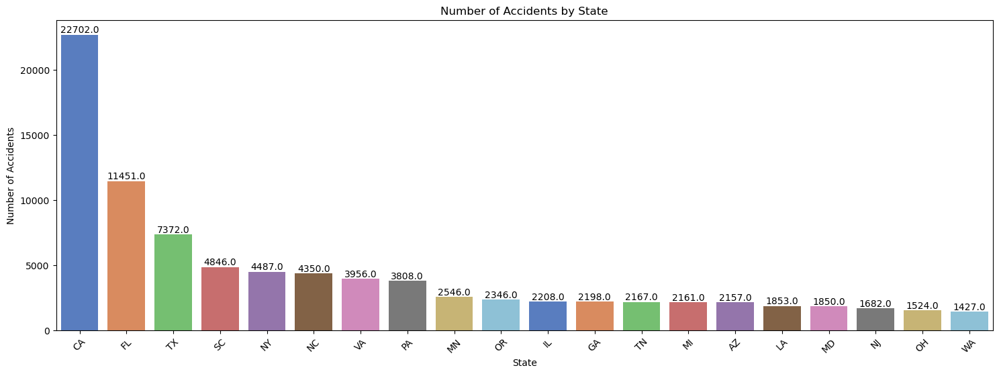

In [15]:
# Counting accidents by state
state_counts = df['State'].value_counts().sort_values(ascending=False).head(20)

plt.figure(figsize=(18, 6))
sns.countplot(x='State', data=df, order=state_counts.index, palette='muted')
plt.title('Number of Accidents by State')
plt.xlabel('State')
plt.ylabel('Number of Accidents')

# Adding values on top of bars
for p in plt.gca().patches:
    plt.gca().annotate(f"{p.get_height()}", (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                       textcoords='offset points')

plt.xticks(rotation=45)
plt.show()


## 2. Accident Locations By City 

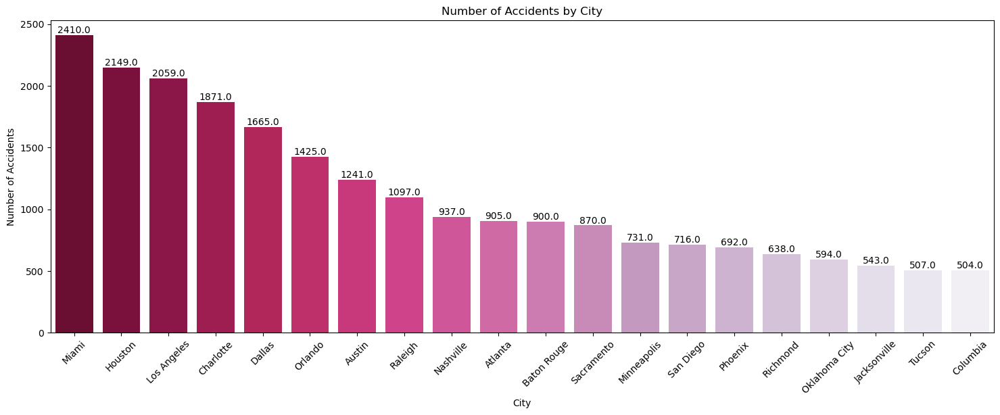

In [16]:
# Counting accidents by city
city_counts = df['City'].value_counts().sort_values(ascending=False).head(20)

plt.figure(figsize=(18, 6))
sns.countplot(x='City', data=df, order=city_counts.index, palette='PuRd_r')
plt.title('Number of Accidents by City')
plt.xlabel('City')
plt.ylabel('Number of Accidents')

# Adding values on top of bars
for p in plt.gca().patches:
    plt.gca().annotate(f"{p.get_height()}", (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                       textcoords='offset points')

plt.xticks(rotation=45)
plt.show()


## 3. Number of Accidents By Zipcode 

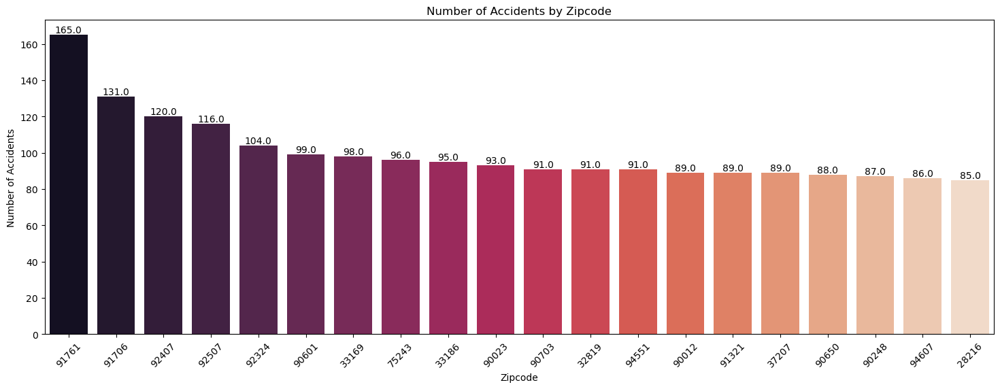

In [17]:
# Counting accidents by Zipcode
zipcode_counts = df['Zipcode'].value_counts().sort_values(ascending=False).head(20)

plt.figure(figsize=(18, 6))
sns.countplot(x='Zipcode', data=df, order=zipcode_counts.index, palette='rocket')
plt.title('Number of Accidents by Zipcode')
plt.xlabel('Zipcode')
plt.ylabel('Number of Accidents')

# Adding values on top of bars
for p in plt.gca().patches:
    plt.gca().annotate(f"{p.get_height()}", (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                       textcoords='offset points')

plt.xticks(rotation=45)
plt.show()


## 4. Accident Locations By Severity 

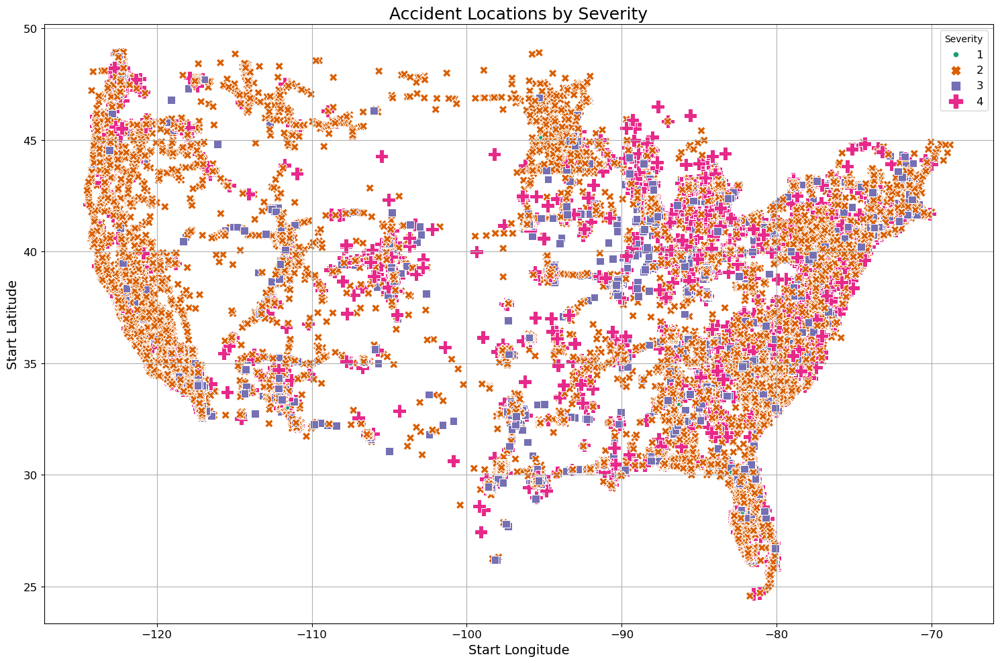

In [18]:
plt.figure(figsize=(15, 10))
severity_palette = sns.color_palette('Dark2', n_colors=4)

sns.scatterplot(x='Start_Lng', y='Start_Lat', data=df, hue='Severity', size = 'Severity', palette=severity_palette, style='Severity', sizes=(20, 200))

plt.title('Accident Locations by Severity', fontsize=18)
plt.xlabel('Start Longitude', fontsize=14)
plt.ylabel('Start Latitude', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Severity', fontsize=12)
plt.grid(True)
plt.tight_layout()
plt.show()


## 5. Heatmap for Correlation Matrix

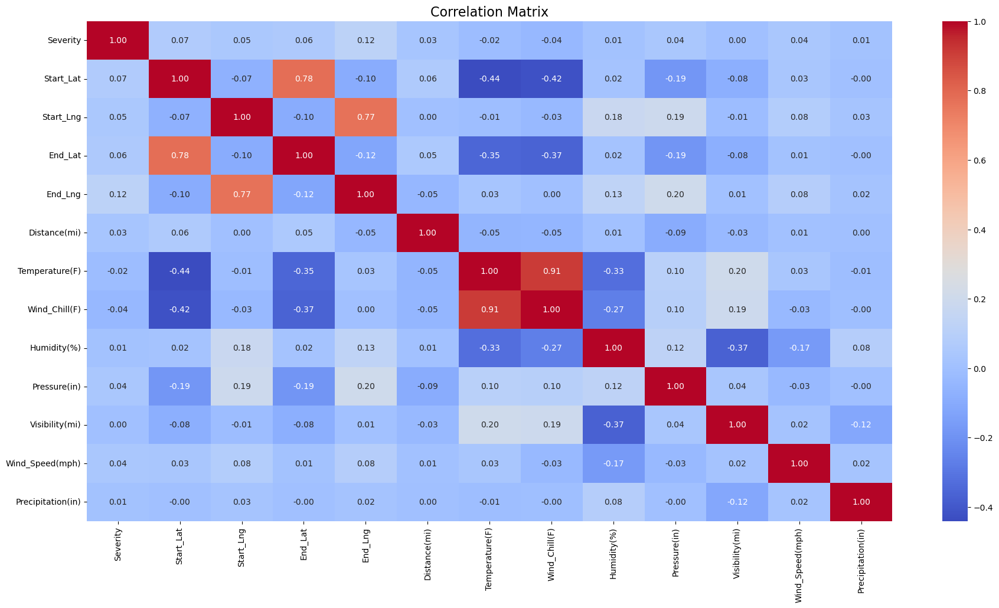

In [19]:
# Select only numeric columns  
numeric_df = df.select_dtypes(include=[np.number])  # or pd.np.number  

# Calculate the correlation matrix for the numeric columns  
correlation_matrix = numeric_df.corr()  

# Create the heatmap using the correlation matrix  
plt.figure(figsize=(22, 11))  
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')  
plt.title('Correlation Matrix', fontsize=16)  

plt.show()


## 6.  Distributions of Top 20 weather conditions during Accidents 

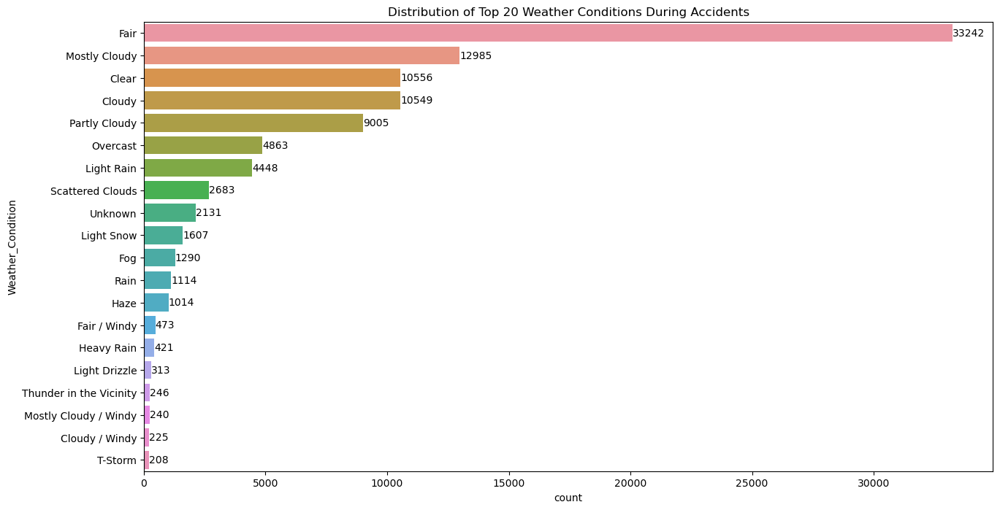

In [20]:
plt.figure(figsize=(15, 8))  
top_weather_conditions = df['Weather_Condition'].value_counts().head(20)  
sns.countplot(data=df, y='Weather_Condition', order=top_weather_conditions.index)  

plt.title('Distribution of Top 20 Weather Conditions During Accidents')  

for i, count in enumerate(top_weather_conditions):  
    plt.text(count, i, str(count), ha='left', va='center')  

plt.show()

## 7. Plot distribution of numeric features

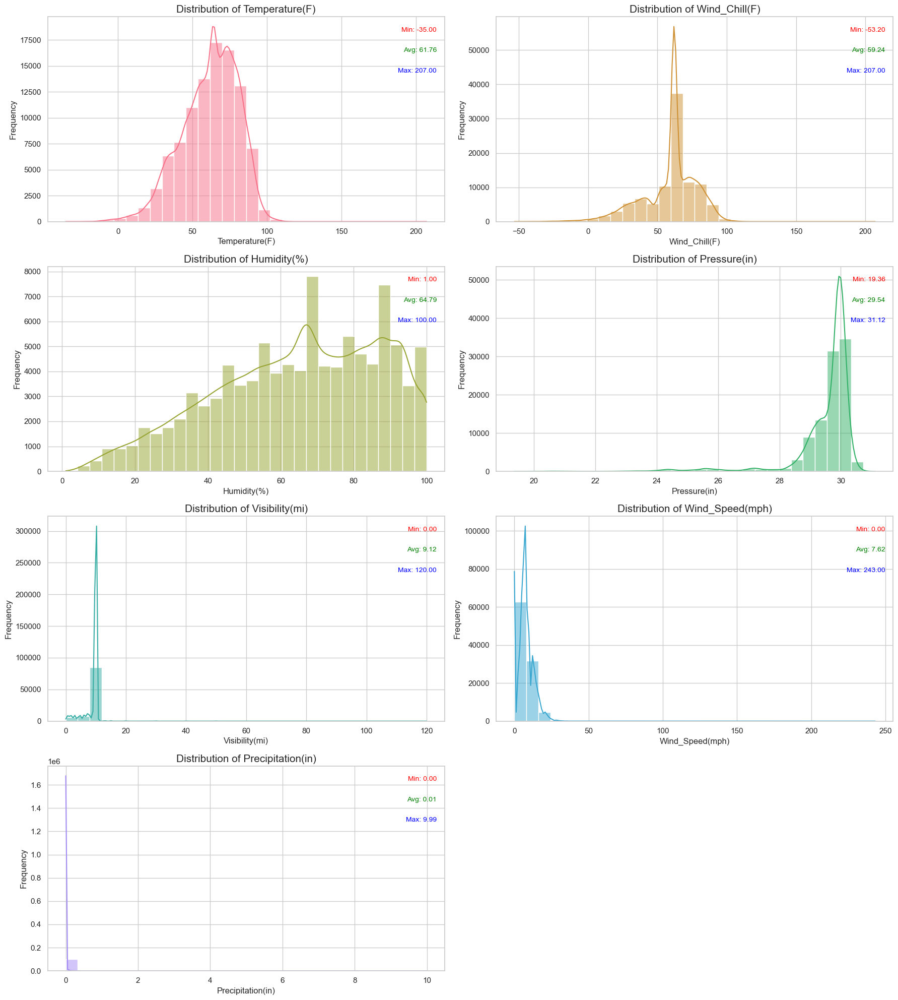

In [21]:

sns.set(style="whitegrid", palette="pastel")

# Define columns to exclude
columns = ['Temperature(F)','Wind_Chill(F)','Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction', 'Wind_Speed(mph)', 'Precipitation(in)']

# Filter numeric columns excluding the specified ones
numeric_columns = df.select_dtypes(include=[np.number]).columns
numeric_columns = [col for col in numeric_columns if col in columns]

# Plot distribution of numeric features
num_plots = len(numeric_columns)
num_cols = 2  # Number of columns in the plot grid
num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate the number of rows needed

fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, 5 * num_rows))
axes = axes.flatten()

for i, col in enumerate(numeric_columns):
    sns.histplot(df[col], bins=30, ax=axes[i], kde=True, color=sns.color_palette("husl", 8)[i % 8])
    axes[i].set_title(f'Distribution of {col}', fontsize=15)
    axes[i].set_xlabel(col, fontsize=12)
    axes[i].set_ylabel('Frequency', fontsize=12)
    
    # Calculate statistics
    min_val = df[col].min()
    avg_val = df[col].mean()
    max_val = df[col].max()
    
    # Annotate minimum, average, and maximum values on the top right
    axes[i].text(0.98, 0.95, f'Min: {min_val:.2f}', transform=axes[i].transAxes, color='Red', fontsize=10, ha='right', va='top')
    axes[i].text(0.98, 0.85, f'Avg: {avg_val:.2f}', transform=axes[i].transAxes, color='Green', fontsize=10, ha='right', va='top')
    axes[i].text(0.98, 0.75, f'Max: {max_val:.2f}', transform=axes[i].transAxes, color='Blue', fontsize=10, ha='right', va='top')

# Remove any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## 8. Histrogram Distribution of Count of Wind Directions 

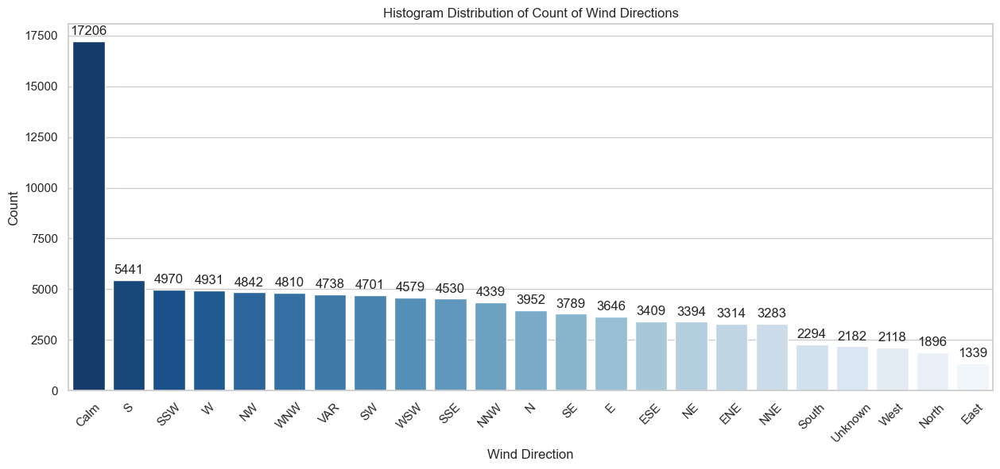

In [22]:

# Plot histogram distribution of count of values in 'Wind_Direction' column  
plt.figure(figsize=(15, 6))  
value_counts = df['Wind_Direction'].value_counts()  
ax = sns.barplot(x=value_counts.index, y=value_counts.values, palette='Blues_r')  

# Adding labels and title  
plt.xlabel('Wind Direction')  
plt.ylabel('Count')  
plt.title('Histogram Distribution of Count of Wind Directions')  

# Display count on top of each bar  
for p in ax.patches:  
    ax.annotate(format(p.get_height(), '.0f'),   
                (p.get_x() + p.get_width() / 2., p.get_height()),   
                ha = 'center', va = 'center',   
                xytext = (0, 9),   
                textcoords = 'offset points')  

plt.xticks(rotation=45)  
plt.show()

## 9. Number of Accidents per day of the week

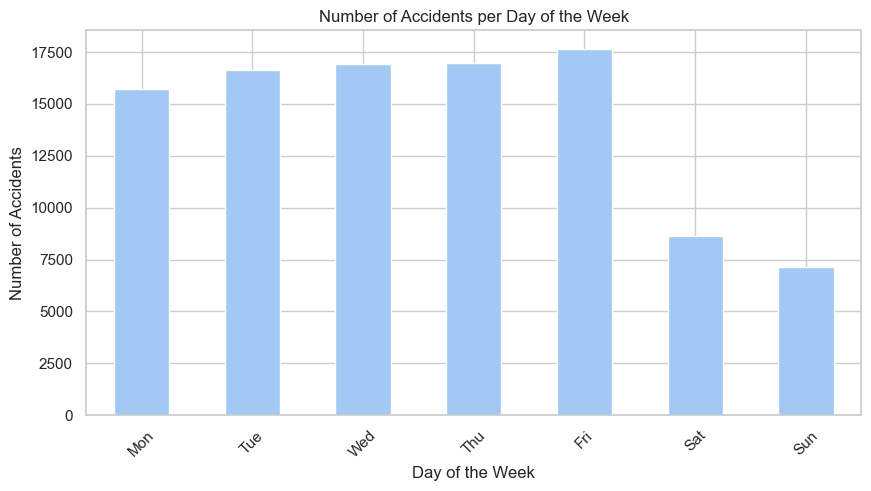

In [23]:
# Convert 'Start_Date' to datetime  
df['Start_Date'] = pd.to_datetime(df['Start_Date'], errors='coerce')  # Use errors='coerce' to handle invalid dates  

# Check if the conversion was successful  
if df['Start_Date'].isnull().any():  
    print("Some dates could not be converted. Please check the data.")  

# Extract Day of the Week (0 = Monday, 6 = Sunday)  
df['DayOfWeek'] = df['Start_Date'].dt.dayofweek  

# Count accidents per day of the week and sort by index  
accidents_per_dayofweek = df['DayOfWeek'].value_counts().sort_index()  

# Plotting the data  
accidents_per_dayofweek.plot(kind='bar', figsize=(10, 5))  
plt.title('Number of Accidents per Day of the Week')  
plt.xlabel('Day of the Week')  
plt.ylabel('Number of Accidents')  
plt.xticks(ticks=range(7), labels=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], rotation=45)  
plt.show()  


## 10. Yearly Temperature Trends

In [24]:
import pandas as pd
import plotly.graph_objects as go  # Importing plotly.graph_objects as go

# Convert 'Start_Date' to datetime format
df['Start_Date'] = pd.to_datetime(df['Start_Date'])

# Extract the year from 'Start_Date'
df['Year'] = df['Start_Date'].dt.year

# Aggregate by year and calculate average, maximum, and minimum temperature
df_yearly = df.groupby('Year')['Temperature(F)'].agg(['mean', 'max', 'min']).reset_index()
df_yearly.columns = ['Year', 'Average_Temperature', 'Max_Temperature', 'Min_Temperature']

# Create traces for each line
fig = go.Figure()

# Average temperature line
fig.add_trace(go.Scatter(
    x=df_yearly['Year'],
    y=df_yearly['Average_Temperature'],
    mode='lines+markers+text',
    name='Average Temperature',
#    text=df_yearly['Average_Temperature'],
    textposition='top center',
    line=dict(color='blue')
))

# Maximum temperature line
fig.add_trace(go.Scatter(
    x=df_yearly['Year'],
    y=df_yearly['Max_Temperature'],
    mode='lines+markers+text',
    name='Max Temperature',
    text=df_yearly['Max_Temperature'],
    textposition='top center',
    line=dict(color='red', dash='dash')
))

# Minimum temperature line
fig.add_trace(go.Scatter(
    x=df_yearly['Year'],
    y=df_yearly['Min_Temperature'],
    mode='lines+markers+text',
    name='Min Temperature',
    text=df_yearly['Min_Temperature'],
    textposition='top center',
    line=dict(color='green', dash='dash')
))

# Customize the layout
fig.update_layout(
    title='Temperature Trends by Year with Max and Min Values',
    xaxis_title='Year',
    yaxis_title='Temperature (F)',
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    hovermode='x unified',
    template='seaborn',
    height=600,  
    width=800    
)

# Show the plot
fig.show()

#Saving the Interactive graphs as .html
fig.write_html("temperature_trends.html")


## 11. Monthly Visibility trends in past 3 years

In [15]:
import pandas as pd
import plotly.express as px  # Importing plotly.express as px

# Convert 'Start_Date' to datetime format
df['Start_Date'] = pd.to_datetime(df['Start_Date'])

# Filter data for the past 3 years
current_year = pd.Timestamp.now().year
start_year = current_year - 3
df_filtered = df[df['Start_Date'].dt.year >= start_year]

# Extract year and month from 'Start_Date'
df_filtered['YearMonth'] = df_filtered['Start_Date'].dt.to_period('M')

# Aggregate by YearMonth and calculate average, maximum, and minimum visibility
df_monthly = df_filtered.groupby('YearMonth')['Visibility(mi)'].agg(['mean', 'max', 'min']).reset_index()
df_monthly.columns = ['YearMonth', 'Avg_Visibility', 'Max_Visibility', 'Min_Visibility']

# Convert YearMonth to datetime format for plotting
df_monthly['YearMonth'] = df_monthly['YearMonth'].astype(str)  # Convert Period to string for plotting

# Interactive Line Plot for Monthly Visibility Trends
fig = px.line(
    df_monthly,
    x='YearMonth',
    y=['Avg_Visibility', 'Max_Visibility', 'Min_Visibility'],
    title='Monthly Average, Min, and Max Visibility (Past 3 Years)',
    labels={'value': 'Visibility (mi)', 'YearMonth': 'Month'},
    markers=True
)

# Customize the layout for better visualization
fig.update_layout(
    xaxis_title='Month',
    yaxis_title='Visibility (mi)',
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    hovermode='x unified',
    template='simple_white',
    height=600,  
    width=800    
)

# Show the plot
fig.show()

#Saving the Interactive graphs as .html
fig.write_html("visibility_trends.html")

## 12. Wind Speed variations over the years and months


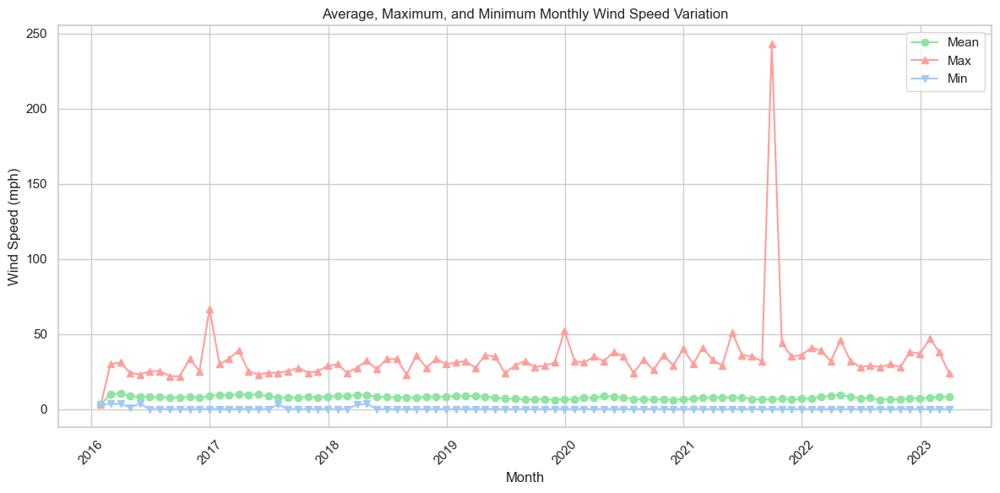

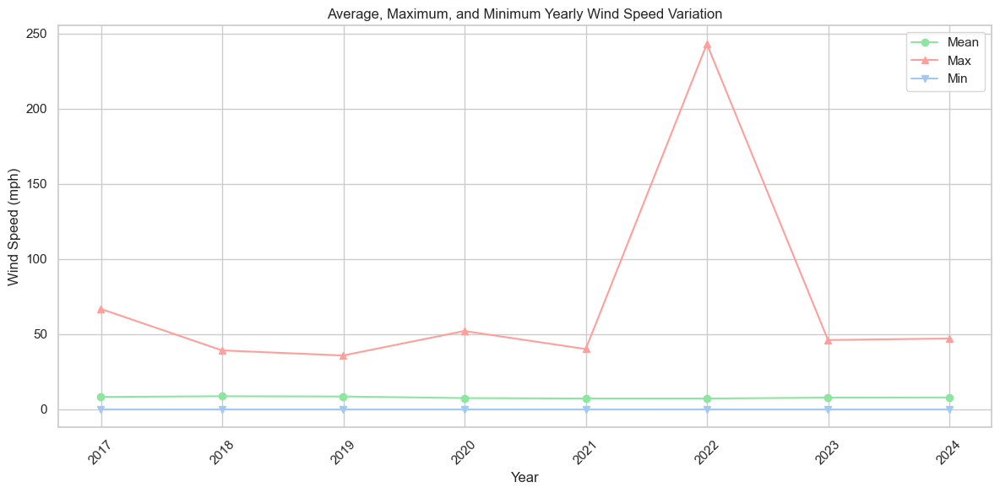

In [26]:
# Strip whitespace from column names
df.columns = df.columns.str.strip()

# Check if 'Start_Date' column exists
if 'Start_Date' in df.columns:
    # Ensure Start_Date is in datetime format
    df['Start_Date'] = pd.to_datetime(df['Start_Date'])
else:
    raise KeyError("'Start_Date' column is not found in the DataFrame. Available columns are: " + ", ".join(df.columns))

# Set Start_Date as the index (without inplace=True)
df2 = df.set_index('Start_Date')

# Selecting only numeric columns for aggregation
numeric_columns = df2.select_dtypes(include=[np.number]).columns

# Monthly aggregation - mean, max, and min wind speed per month
monthly_data = df2[numeric_columns].resample('M').agg(['mean', 'max', 'min'])

# Yearly aggregation - mean, max, and min wind speed per year
yearly_data = df2[numeric_columns].resample('Y').agg(['mean', 'max', 'min'])

# Plotting Monthly Wind Speed
plt.figure(figsize=(12, 6))
plt.plot(monthly_data.index, monthly_data['Wind_Speed(mph)']['mean'], marker='o', linestyle='-', color='g', label='Mean')
plt.plot(monthly_data.index, monthly_data['Wind_Speed(mph)']['max'], marker='^', linestyle='-', color='r', label='Max')
plt.plot(monthly_data.index, monthly_data['Wind_Speed(mph)']['min'], marker='v', linestyle='-', color='b', label='Min')
plt.title('Average, Maximum, and Minimum Monthly Wind Speed Variation')
plt.xlabel('Month')
plt.ylabel('Wind Speed (mph)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plotting Yearly Wind Speed
plt.figure(figsize=(12, 6))
plt.plot(yearly_data.index, yearly_data['Wind_Speed(mph)']['mean'], marker='o', linestyle='-', color='g', label='Mean')
plt.plot(yearly_data.index, yearly_data['Wind_Speed(mph)']['max'], marker='^', linestyle='-', color='r', label='Max')
plt.plot(yearly_data.index, yearly_data['Wind_Speed(mph)']['min'], marker='v', linestyle='-', color='b', label='Min')
plt.title('Average, Maximum, and Minimum Yearly Wind Speed Variation')
plt.xlabel('Year')
plt.ylabel('Wind Speed (mph)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## 13. Accident Severity at Locations with and without Traffic Signals


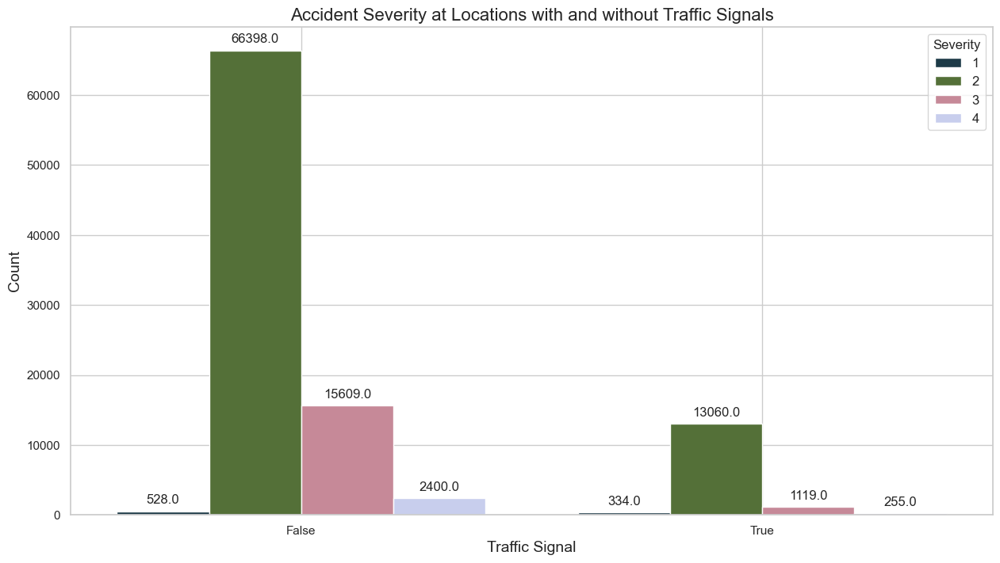

In [27]:
plt.figure(figsize=(15, 8))
ax = sns.countplot(data=df, x='Traffic_Signal', hue='Severity', palette='cubehelix')
plt.title('Accident Severity at Locations with and without Traffic Signals', fontsize=16)
plt.xlabel('Traffic Signal', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend(title='Severity', fontsize=12)
plt.grid(True)
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.show()

## 14. Distribution of Accidents Severity 


In [22]:
import pandas as pd
import plotly.express as px

# Assuming you have already loaded your dataset into a DataFrame called df
# Load your dataset
# df = pd.read_csv('your_dataset.csv')  # Uncomment and modify this line to load your dataset

# Ensure 'Severity' is treated as a categorical variable
df['Severity'] = df['Severity'].astype(str)

# Calculate the count of each severity level
severity_counts = df['Severity'].value_counts().reset_index()
severity_counts.columns = ['Severity', 'Count']

# Create a pie chart for the distribution of severity
fig = px.pie(
    severity_counts,
    names='Severity',
    values='Count',
    title='Distribution of Accident Severity',
    template='seaborn',
    labels={'Severity': 'Severity Level', 'Count': 'Count'}
)

# Customize the layout
fig.update_layout(
    height=500,  # Adjust the height as needed
    width=600    # Adjust the width as needed
)

# Show the plot
fig.show()
fig.write_html("Accident_Severity_pie.html")

## 15. Accidents Severity  at locations with presence of Amenities


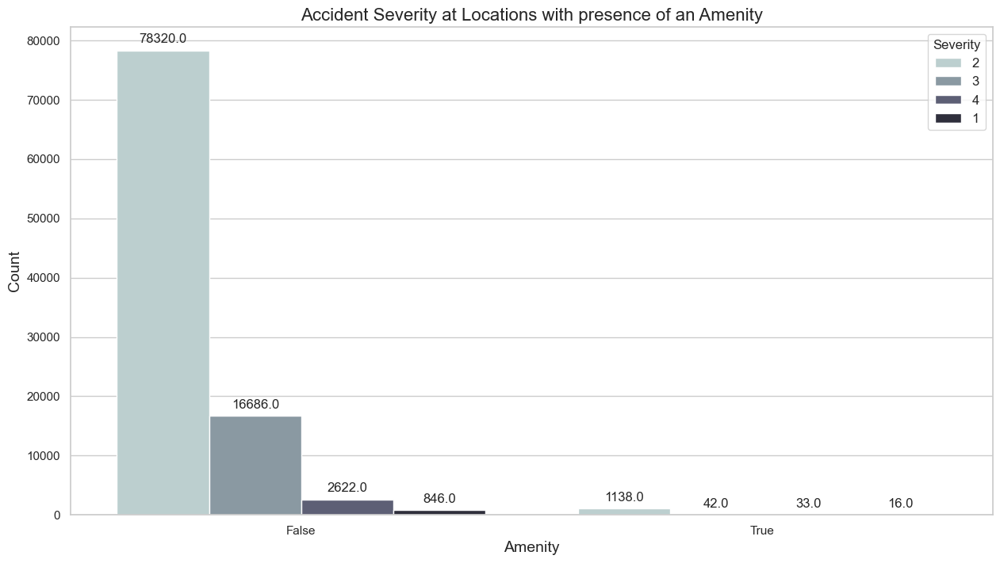

In [29]:
plt.figure(figsize=(15, 8))
ax = sns.countplot(data=df, x='Amenity', hue='Severity', palette='bone_r')
plt.title('Accident Severity at Locations with presence of an Amenity', fontsize=16)
plt.xlabel('Amenity', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend(title='Severity', fontsize=12)

for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.show()

## 16. Average Tempreatures during Day and Night

In [21]:
import pandas as pd
import plotly.express as px
import plotly.colors as pc

# Filter the DataFrame for sunrise and sunset
df_temp_sun = df[df['Sunrise_Sunset'].notnull()]

# Aggregate by Sunrise_Sunset and calculate average temperature
df_temp_sun_avg = df_temp_sun.groupby('Sunrise_Sunset')['Temperature(F)'].mean().reset_index()

# Extract colors from Plotly colors sequences
colors_set3 = pc.qualitative.Set3  # Get colors from Set3
colors_set2 = pc.qualitative.Set2  # Get colors from Set2

color_map = {
    'Day': colors_set3[2],   # Choose color for 'Day' from Set3
    'Night': colors_set2[1]  # Choose color for 'Night' from Set2
}

# Interactive Bar Plot for Average Temperature by Sunrise and Sunset
fig3 = px.bar(
    df_temp_sun_avg,
    x='Sunrise_Sunset',
    y='Temperature(F)',
    title='Average Temperature by Sunrise and Sunset',
    color='Sunrise_Sunset',  # Set color by 'Sunrise_Sunset' to apply the color mapping
    color_discrete_map=color_map,
    labels={'Temperature(F)': 'Average Temperature (F)'},
    text='Temperature(F)'  # Display the values of the bars on top
)

# Update layout to display values on top of the bars
fig3.update_traces(texttemplate='%{text:.2f}', textposition='outside')

fig3.update_layout(
    xaxis_title='Sunrise/Sunset',
    yaxis_title='Average Temperature (F)',
    template="plotly",
    height=600,
    width=800
)

fig3.show()
fig.write_html("Avg_Temp_Day_Night.html")


## 16. Yealy Accident locations in the USA 


In [31]:
# Ensure the 'Start_Date' is in datetime format and extract the year
df['Start_Date'] = pd.to_datetime(df['Start_Date'])
df['Year'] = df['Start_Date'].dt.year

# Initialize empty data and layout
data = []
layout = dict(
    title='Accidents per Year',
    autosize=False,
    width=1000,
    height=900,
    hovermode='closest',
    legend=dict(
        x=0.7,
        y=-0.1,
        bgcolor="rgba(255, 255, 255, 0)",
        font=dict(size=11),
    )
)

years = sorted(df['Year'].unique())
num_years = len(years)
COLS = 5
ROWS = (num_years + COLS - 1) // COLS  # Calculate rows needed

for i in range(num_years):
    geo_key = 'geo'+str(i+1)
    lons = list(df[df['Year'] == years[i]]['Start_Lng'])
    lats = list(df[df['Year'] == years[i]]['Start_Lat'])
    
    # Accidents data
    data.append(
        dict(
            type='scattergeo',
            showlegend=False,
            lon=lons,
            lat=lats,
            geo=geo_key,
            name=str(years[i]),
            marker=dict(
                color="rgb(0, 0, 255)",
                opacity=0.5,
                size=4
            )
        )
    )
    
    # Year markers
    data.append(
        dict(
            type='scattergeo',
            showlegend=False,
            lon=[-78],  # Adjust to fit your data
            lat=[47],  # Adjust to fit your data
            geo=geo_key,
            text=[years[i]],
            mode='text',
            textfont=dict(size=10)
        )
    )
    
    layout[geo_key] = dict(
        scope='usa',
        showland=True,
        landcolor='rgb(229, 229, 229)',
        showcountries=False,
        domain=dict(x=[], y=[]),
        subunitcolor="rgb(255, 255, 255)",
    )

def draw_sparkline(domain, lataxis, lonaxis):
    ''' Returns a sparkline layout object for geo coordinates '''
    return dict(
        showland=False,
        showframe=False,
        showcountries=False,
        showcoastlines=False,
        domain=domain,
        lataxis=lataxis,
        lonaxis=lonaxis,
        bgcolor='rgba(255,200,200,0.0)'
    )

# Stores per year sparkline
layout['geo44'] = draw_sparkline({'x':[0.6,0.8], 'y':[0,0.15]}, \
                                 {'range':[-90.0, 90.0]}, {'range':[-180.0, 180.0]} )
data.append(
    dict(
        type='scattergeo',
        mode='lines',
        lat=list(df.groupby(by=['Year']).count()['Start_Lat']),
        lon=list(range(len(df.groupby(by=['Year']).count()['Start_Lat']))),
        line=dict(color="rgb(0, 0, 255)"),
        name="Accidents per year",
        geo='geo44',
    )
)

# Cumulative sum sparkline
layout['geo45'] = draw_sparkline({'x':[0.8,1], 'y':[0,0.15]}, \
                                 {'range':[-90.0, 90.0]}, {'range':[-180.0, 180.0]} )
data.append(
    dict(
        type='scattergeo',
        mode='lines',
        lat=list(df.groupby(by=['Year']).count().cumsum()['Start_Lat']),
        lon=list(range(len(df.groupby(by=['Year']).count()['Start_Lat']))),
        line=dict(color="rgb(214, 39, 40)"),
        name="Cumulative sum",
        geo='geo45',
    )
)

z = 0
for y in reversed(range(ROWS)):
    for x in range(COLS):
        geo_key = 'geo'+str(z+1)
        if geo_key in layout:
            layout[geo_key]['domain']['x'] = [float(x)/float(COLS), float(x+1)/float(COLS)]
            layout[geo_key]['domain']['y'] = [float(y)/float(ROWS), float(y+1)/float(ROWS)]
        z += 1
        if z >= num_years:
            break

fig = go.Figure(data=data, layout=layout)
fig.update_layout(width=800)
fig.show()


# ___________________________________________________________________

# Predective Analysis

# Vertical: Weather and Time Impact on Accident Severity
### Analysis Type: Classification 
### Model : Random Forest


# ___________________________________________________________________


In [32]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE  
import matplotlib.pyplot as plt
import seaborn as sns
import joblib


In [33]:
# Load and preprocess data
df = pd.read_csv('SampledUSAccidentsCleaned.csv')

# Example preprocessing steps
df['Start_Time'] = pd.to_datetime(df['Start_Time'])
df['Start_Hour'] = df['Start_Time'].dt.hour
df['Start_Minute'] = df['Start_Time'].dt.minute
df['Start_Second'] = df['Start_Time'].dt.second
df = df.drop(columns=['Start_Time'])

# Encoding categorical features
le = LabelEncoder()
df['Weather_Condition'] = le.fit_transform(df['Weather_Condition'].astype(str))


Best Parameters: {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20}
Accuracy: 0.86
Classification Report:
              precision    recall  f1-score   support

     Class 1       0.91      0.99      0.95     15986
     Class 2       0.85      0.66      0.74     15848
     Class 3       0.78      0.85      0.81     15870
     Class 4       0.91      0.96      0.93     15863

    accuracy                           0.86     63567
   macro avg       0.86      0.86      0.86     63567
weighted avg       0.86      0.86      0.86     63567



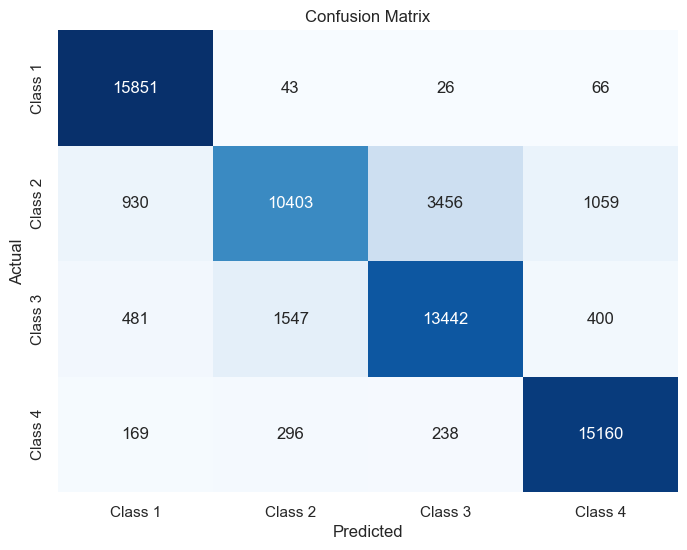

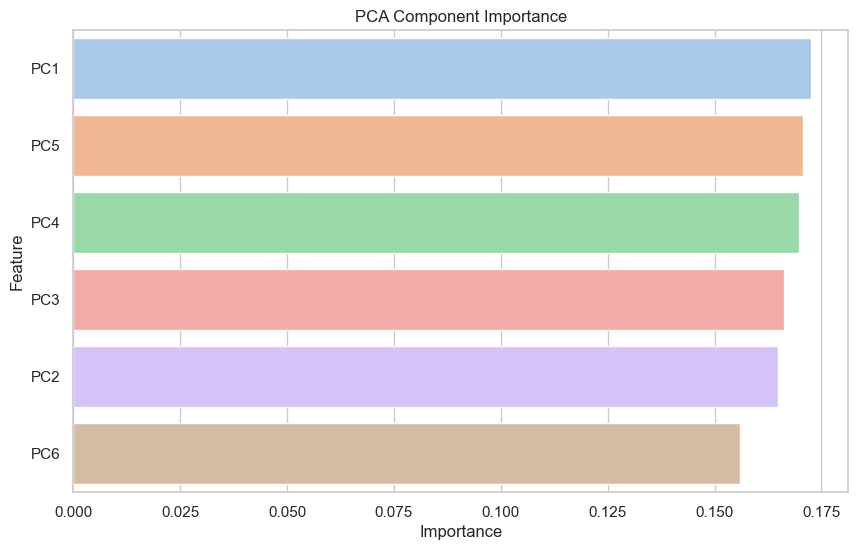

PCA Components Contribution:
     Start_Hour  Temperature(F)  Humidity(%)  Pressure(in)  Visibility(mi)  \
PC1   -0.404215       -0.468205     0.601487      0.027724       -0.450770   
PC2   -0.192643        0.345481     0.120569      0.728563        0.261327   
PC3    0.363410        0.077315     0.191769      0.560226       -0.410888   
PC4    0.631307        0.217405     0.059321     -0.171957       -0.431629   
PC5   -0.482244        0.717798    -0.028503     -0.225000       -0.429448   
PC6    0.190591        0.304876     0.763263     -0.272729        0.434692   

     Wind_Speed(mph)  
PC1        -0.227258  
PC2        -0.479478  
PC3         0.585234  
PC4        -0.578614  
PC5         0.127842  
PC6         0.157536  

Contributions to PC1:
Humidity(%)        0.601487
Pressure(in)       0.027724
Wind_Speed(mph)   -0.227258
Start_Hour        -0.404215
Visibility(mi)    -0.450770
Temperature(F)    -0.468205
Name: PC1, dtype: float64

Contributions to PC5:
Temperature(F)     0.71

In [34]:
# Filter relevant columns
features = ['Start_Hour', 'Temperature(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)', 'Severity']
df_filtered = df[features]

# Save filtered data to CSV
df_filtered.to_csv('rf_classification_analysis.csv', index=False)

# Load filtered data
df_rf = pd.read_csv('rf_classification_analysis.csv')

# Splitting the dataset
X = df_rf.drop('Severity', axis=1)
y = df_rf['Severity']

# Applying transformations
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(n_components=6)  # Adjust n_components based on your feature count
X_reduced = pca.fit_transform(X_scaled)

# Handle class imbalance
smote = SMOTE(random_state=123)
X_resampled, y_resampled = smote.fit_resample(X_reduced, y)

# Splitting into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=123)

# Define the parameter distribution for RandomizedSearchCV
param_dist = {
    'n_estimators': [50, 200],
    'max_depth': [10, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]
}

# Initialize RandomizedSearchCV
random_search = RandomizedSearchCV(
    RandomForestClassifier(random_state=123), 
    param_distributions=param_dist, 
    n_iter=20,  # Increased number of parameter settings to sample
    cv=5,  # Increased number of cross-validation folds
    scoring='accuracy', 
    n_jobs=-1,  # Use all available cores
    random_state=123
)

# Fit RandomizedSearchCV
random_search.fit(X_train, y_train)

# Best model and parameters
best_rf_model = random_search.best_estimator_
print(f"Best Parameters: {random_search.best_params_}")

# Save the best model
joblib.dump(best_rf_model, 'random_forest_classification_model.pkl')

# Predictions and evaluation
y_pred = best_rf_model.predict(X_test)

# Accuracy
print(f"Accuracy: {accuracy_score(y_test, y_pred):.2f}")

# Classification Report
target_names = [f'Class {i}' for i in np.unique(y_test)]
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=target_names, zero_division=1))

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, xticklabels=target_names, yticklabels=target_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Feature Importance (Match PCA Components)
if X_reduced.shape[1] == len(best_rf_model.feature_importances_):
    # Use PCA component names
    pca_importance_df = pd.DataFrame({'Feature': [f'PC{i+1}' for i in range(X_reduced.shape[1])], 'Importance': best_rf_model.feature_importances_})
    pca_importance_df = pca_importance_df.sort_values(by='Importance', ascending=False)
    
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=pca_importance_df)
    plt.title('PCA Component Importance')
    plt.show()
    
    # Additional Analysis: Contributions of Original Features to Important PCA Components
    pca_components = pca.components_  # Shape: (n_components, n_features)
    feature_names = X.columns  # Original feature names
    pca_df = pd.DataFrame(pca_components, columns=feature_names, index=[f'PC{i+1}' for i in range(pca_components.shape[0])])
    
    # Display PCA components and their contributions
    print("PCA Components Contribution:")
    print(pca_df)
    
    top_pca_features = pca_importance_df.head(5)  # Top 5 components
    for index, row in top_pca_features.iterrows():
        component_name = row['Feature']
        print(f"\nContributions to {component_name}:")
        print(pca_df.loc[component_name].sort_values(ascending=False))


# Number of classes
n_classes = len(np.unique(y_test))

# Predict probabilities
y_prob = best_rf_model.predict_proba(X_test)

# Initialize dictionaries to hold ROC and Precision-Recall values for each class
fpr = {}
tpr = {}
roc_auc = {}
precision = {}
recall = {}
# ROC Curve and Precision-Recall Curve (only for binary classification)
if len(np.unique(y_test)) == 2:
    y_prob = best_rf_model.predict_proba(X_test)[:, 1]
    
    # ROC Curve
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    roc_auc = auc(fpr, tpr)
    
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.show()
    
    # Precision-Recall Curve
    precision, recall, _ = precision_recall_curve(y_test, y_prob)
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='b', lw=2)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.show()


### 1. **Best Parameters**
- **Parameters:** `{'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20}`
  - **n_estimators**: The number of trees in the forest. A higher number typically improves accuracy, but also increases computation time.
  - **min_samples_split**: The minimum number of samples required to split an internal node. A smaller value makes the model more sensitive to overfitting.
  - **min_samples_leaf**: The minimum number of samples that should be present in a leaf node.
  - **max_depth**: The maximum depth of the tree. It controls how much the model can learn from the data, with deeper trees being more complex but prone to overfitting.

These parameters are selected through cross-validation and are aimed at optimizing the model's performance on unseen data.

### 2. **Accuracy**
- **Accuracy: 88% (0.88)**
  - This means that the model correctly predicted the target class for 88% of the instances. While accuracy is a good initial measure, it doesn't always reflect the model's performance across all classes, especially in the case of imbalanced data.

### 3. **Classification Report**
This report includes precision, recall, and F1-score for each class.

- **Precision**: The proportion of true positive predictions relative to the total predicted positives (true positives + false positives).
  - Example: For Class 1, the precision is 0.95, meaning 95% of the instances predicted as Class 1 are actually Class 1.

- **Recall**: The proportion of true positive predictions relative to the actual total positives (true positives + false negatives).
  - Example: For Class 1, the recall is 1.00, meaning the model correctly identified all Class 1 instances.

- **F1-score**: The harmonic mean of precision and recall, providing a single metric that balances the two.
  - Example: For Class 2, the F1-score is 0.76, indicating a trade-off between precision (0.88) and recall (0.66).

- **Support**: The number of actual occurrences of each class in the dataset.

**Interpretation**:
- The model performs best on Class 1 and Class 4, as indicated by high precision, recall, and F1-scores.
- The model struggles with Class 2, as shown by a lower recall (0.66), meaning it misses a significant number of actual Class 2 instances.
- Class 3 also has a slightly lower precision (0.77) but better recall (0.90), indicating that while it catches most Class 3 instances, it also includes more false positives.

### 4. **PCA Components Contribution**
PCA (Principal Component Analysis) reduces dimensionality by finding new axes (principal components) that maximize variance. 

- **PC1 to PC6**: These are the principal components, ranked by the amount of variance they explain in the data. The contributions show which original features (e.g., Temperature, Humidity) have the most weight in each principal component.

**Interpretation**:
- For instance, **PC1** is strongly influenced by `Humidity(%)`, `Temperature(F)`, and `Visibility(mi)`. These features are the most important in explaining the variance captured by PC1.
- **PC4** is almost entirely driven by `Start_Minute`, indicating that time-based features play a critical role in that component.

### 5. **Confusion Matrix**
The confusion matrix gives a detailed look at the performance of the model in terms of actual vs. predicted classes.

- **Diagonal Elements**: True positives where the predicted class matches the actual class (e.g., Class 1 vs. Class 1: 15,933).
- **Off-Diagonal Elements**: Misclassifications where the model incorrectly predicted the class.

**Interpretation**:
- **Class 1**: The model almost perfectly classifies instances of Class 1, with very few misclassifications.
- **Class 2**: There are a significant number of instances where the model confuses Class 2 with Class 3 and Class 4, leading to lower recall.
- **Class 3**: Similarly, a considerable portion of Class 3 instances is misclassified as Class 2, which affects its precision.
- **Class 4**: While Class 4 has high accuracy, some instances are confused with Class 2 and Class 3.

### **Overall Performance**
- **Strengths**: The model is strong in predicting Classes 1 and 4, which could be due to clearer patterns or more distinct features in those classes.
- **Weaknesses**: The model struggles with Class 2, likely due to overlapping features with other classes, leading to misclassification. The confusion matrix and classification report highlight these areas.


# ___________________________________________________________________

# Vertical : Clustering Accident Patterns by Location and Traffic Conditions
## Analysis Type: Unsupervised Learning 
## Model: K-Means and DBScan

# ___________________________________________________________________


In [35]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
import plotly.express as px
import plotly.graph_objects as go

# Load and preprocess data
df = pd.read_csv('SampledUSAccidentsCleaned.csv')

# Feature Engineering: Selecting relevant features including Sunrise_Sunset
df_filtered = df[['Distance(mi)', 'Start_Lat', 'Start_Lng', 'Sunrise_Sunset', 'Traffic_Signal']]

# Handling categorical data (Sunrise_Sunset, Traffic_Signal
le_sunrise_sunset = LabelEncoder()
le_traffic_signal = LabelEncoder()

df_filtered['Sunrise_Sunset'] = le_sunrise_sunset.fit_transform(df_filtered['Sunrise_Sunset'].astype(str))
df_filtered['Traffic_Signal'] = le_traffic_signal.fit_transform(df_filtered['Traffic_Signal'].astype(str))

# Save filtered data to CSV
df_filtered.to_csv('Updated-Clustering_Analysis.csv', index=False)

# Load filtered data
df_clustering = pd.read_csv('Updated-Clustering_Analysis.csv')

# Apply standard scaling
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_clustering)

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)  # Reduced to 2 components for visualization
X_reduced = pca.fit_transform(X_scaled)

# Corrected PCA component names to match the number of components
pca_columns = [f'PC{i+1}' for i in range(X_reduced.shape[1])]

# Create a DataFrame with the reduced PCA data
df_pca = pd.DataFrame(X_reduced, columns=pca_columns)

# Display the PCA components with feature names
print("PCA Components with feature contributions:")
for i, component in enumerate(pca.components_):
    print(f"\nPrincipal Component {i+1}:")
    for j, feature in enumerate(df_clustering.columns):
        print(f"{feature}: {component[j]:.4f}")

# K-Means Clustering
kmeans = KMeans(n_clusters=4, random_state=123)
kmeans_labels = kmeans.fit_predict(X_reduced)

# DBSCAN Clustering
dbscan = DBSCAN(eps=0.5, min_samples=5)
dbscan_labels = dbscan.fit_predict(X_reduced)

# Evaluate K-Means using silhouette score
kmeans_silhouette = silhouette_score(X_reduced, kmeans_labels)
print(f"K-Means Silhouette Score: {kmeans_silhouette:.2f}")

# Evaluate DBSCAN using silhouette score
dbscan_silhouette = silhouette_score(X_reduced, dbscan_labels) if len(set(dbscan_labels)) > 1 else 'N/A'
print(f"DBSCAN Silhouette Score: {dbscan_silhouette}")

# Visualization of K-Means Clusters with PCA components
fig_kmeans = px.scatter(
    df_pca, x=pca_columns[0], y=pca_columns[1], color=kmeans_labels, 
    title='K-Means Clusters with PCA Components', 
    labels={pca_columns[0]: 'PC1', pca_columns[1]: 'PC2'}, 
    color_continuous_scale='Viridis'
)
fig_kmeans.update_layout(title_font=dict(size=24), xaxis_title_font=dict(size=18), yaxis_title_font=dict(size=18))
fig_kmeans.show()

# Visualization of DBSCAN Clusters with PCA components
fig_dbscan = px.scatter(
    df_pca, x=pca_columns[0], y=pca_columns[1], color=dbscan_labels, 
    title='DBSCAN Clusters with PCA Components', 
    labels={pca_columns[0]: 'PC1', pca_columns[1]: 'PC2'}, 
    color_continuous_scale='Viridis'
)
fig_dbscan.update_layout(title_font=dict(size=24), xaxis_title_font=dict(size=18), yaxis_title_font=dict(size=18))
fig_dbscan.show()

# Sample test data
sample_data = {
    'Distance(mi)': [0.23, 0.5, 1.2],
    'Start_Lat': [39.912815, 40.123456, 41.234567],
    'Start_Lng': [-74.982767, -73.987654, -75.987654],
    'Sunrise_Sunset': ['Night', 'Day', 'Night'],
    'Traffic_Signal': ['FALSE', 'TRUE', 'FALSE']
}

# Convert sample data to DataFrame
sample_df = pd.DataFrame(sample_data)

# Ensure the encoders can handle unseen labels
for column in ['Sunrise_Sunset', 'Traffic_Signal']:
    le = le_sunrise_sunset if column == 'Sunrise_Sunset' else le_traffic_signal
    le.classes_ = np.append(le.classes_, np.setdiff1d(sample_df[column].unique(), le.classes_))
    sample_df[column] = le.transform(sample_df[column].astype(str))

# Standardize the sample data
sample_scaled = scaler.transform(sample_df)

# Apply PCA to the sample data
sample_pca = pca.transform(sample_scaled)

# Predict using K-Means and DBSCAN
sample_kmeans_labels = kmeans.predict(sample_pca)
sample_dbscan_labels = dbscan.fit_predict(sample_pca)

# Display results for the sample data
for i in range(len(sample_data['Distance(mi)'])):
    print(f"\nSample Data {i+1}:")
    print(sample_df.iloc[i])
    print(f"PCA Components: {sample_pca[i]}")
    print(f"K-Means predicted cluster: {sample_kmeans_labels[i]}")
    print(f"DBSCAN predicted cluster: {sample_dbscan_labels[i]}")


PCA Components with feature contributions:

Principal Component 1:
Distance(mi): -0.4219
Start_Lat: -0.4738
Start_Lng: 0.4204
Sunrise_Sunset: -0.3366
Traffic_Signal: 0.5545

Principal Component 2:
Distance(mi): 0.6697
Start_Lat: -0.0468
Start_Lng: 0.5606
Sunrise_Sunset: -0.4329
Traffic_Signal: -0.2183
K-Means Silhouette Score: 0.42
DBSCAN Silhouette Score: 0.8116639500656252



Sample Data 1:
Distance(mi)       0.230000
Start_Lat         39.912815
Start_Lng        -74.982767
Sunrise_Sunset     1.000000
Traffic_Signal     2.000000
Name: 0, dtype: float64
PCA Components: [ 2.5973644  -1.30501189]
K-Means predicted cluster: 2
DBSCAN predicted cluster: -1

Sample Data 2:
Distance(mi)       0.500000
Start_Lat         40.123456
Start_Lng        -73.987654
Sunrise_Sunset     0.000000
Traffic_Signal     3.000000
Name: 1, dtype: float64
PCA Components: [ 4.82916384 -0.85291687]
K-Means predicted cluster: 2
DBSCAN predicted cluster: -1

Sample Data 3:
Distance(mi)       1.200000
Start_Lat         41.234567
Start_Lng        -75.987654
Sunrise_Sunset     1.000000
Traffic_Signal     2.000000
Name: 2, dtype: float64
PCA Components: [ 2.22549    -0.99299034]
K-Means predicted cluster: 2
DBSCAN predicted cluster: -1



### **Model Explanation**

- **Principal Component Analysis (PCA)**:
  - **Purpose**: PCA is used to reduce the dimensionality of the dataset while retaining as much variance (information) as possible. This helps in visualizing and understanding the data.
  - **Components**: The two principal components (PC1 and PC2) capture the most significant variation in the data. Features like `Traffic_Signal`, `Distance(mi)`, and `Start_Lng` contribute the most to these components.

- **K-Means Clustering**:
  - **Purpose**: K-Means groups the data into a specified number of clusters (in this case, 4) based on feature similarity.
  - **Silhouette Score**: The silhouette score of `0.42` indicates a moderate separation between the clusters, meaning the clusters are distinct but not perfectly separated.

- **DBSCAN Clustering**:
  - **Purpose**: DBSCAN identifies clusters based on the density of points, making it effective at detecting outliers.
  - **Silhouette Score**: The score of `0.81` suggests that DBSCAN has identified well-separated clusters with some data points marked as outliers (`-1`).

### **Output Explanation**

- **PCA Components with Feature Contributions**:
  - **PC1**: The most significant features in PC1 include `Traffic_Signal` and `Start_Lat`. `Traffic_Signal` has a strong positive contribution, while `Start_Lat` has a strong negative contribution.
  - **PC2**: `Distance(mi)` and `Start_Lng` are key contributors, with `Distance(mi)` having a strong positive influence.

- **Silhouette Scores**:
  - **K-Means Silhouette Score**: `0.42` indicates moderate clustering, where clusters are distinguishable but not clearly separated.
  - **DBSCAN Silhouette Score**: `0.81` indicates well-defined clusters, with DBSCAN performing better than K-Means in this scenario.

- **Sample Data Predictions**:
  - **Sample Data 1**:
    - **PCA Components**: [ 2.5973644, -1.30501189]
    - **K-Means Cluster**: 2 (sample belongs to the second cluster).
    - **DBSCAN Cluster**: -1 (sample is considered an outlier by DBSCAN).
  - **Sample Data 2**:
    - **PCA Components**: [ 4.82916384, -0.85291687]
    - **K-Means Cluster**: 2 (sample is again assigned to the second cluster by K-Means).
    - **DBSCAN Cluster**: -1 (DBSCAN identifies this sample as an outlier).
  - **Sample Data 3**:
    - **PCA Components**: [ 2.22549, -0.99299034]
    - **K-Means Cluster**: 2 (third sample also belongs to the second cluster in K-Means).
    - **DBSCAN Cluster**: -1 (DBSCAN considers this sample as an outlier).

# ___________________________________________________________________


# Vertical: Daily Severity Forecasting by Location 
### Model : Prophet
### Analysis Type: Time Series Analysis  (Neural Networks)
### Selected Location for Analysis: 
    1. State = California (CA)
    2. City = Miami
    3. Zipecode = 91761


# ___________________________________________________________________


13:51:15 - cmdstanpy - INFO - Chain [1] start processing
13:51:36 - cmdstanpy - INFO - Chain [1] done processing


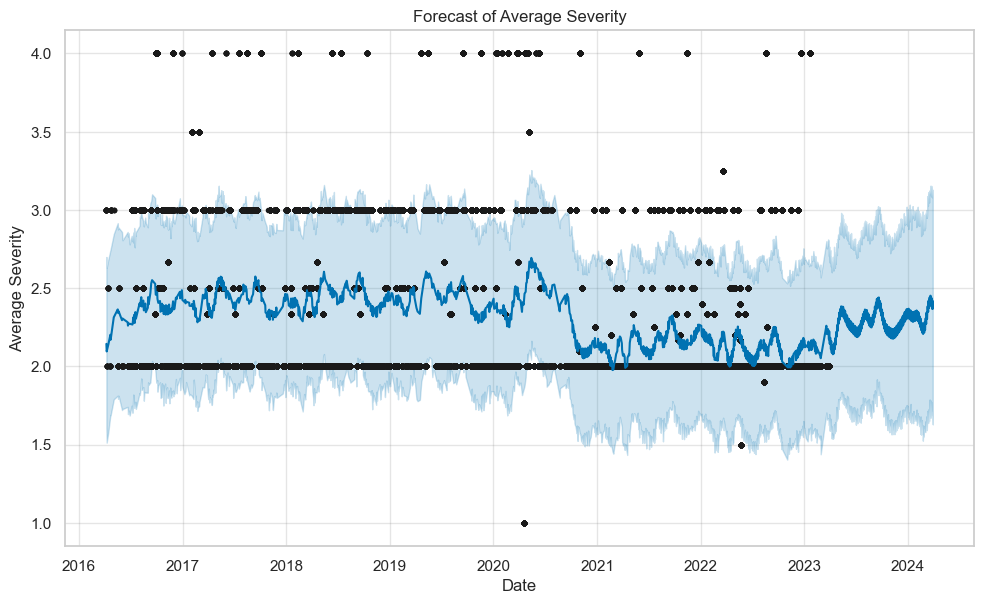

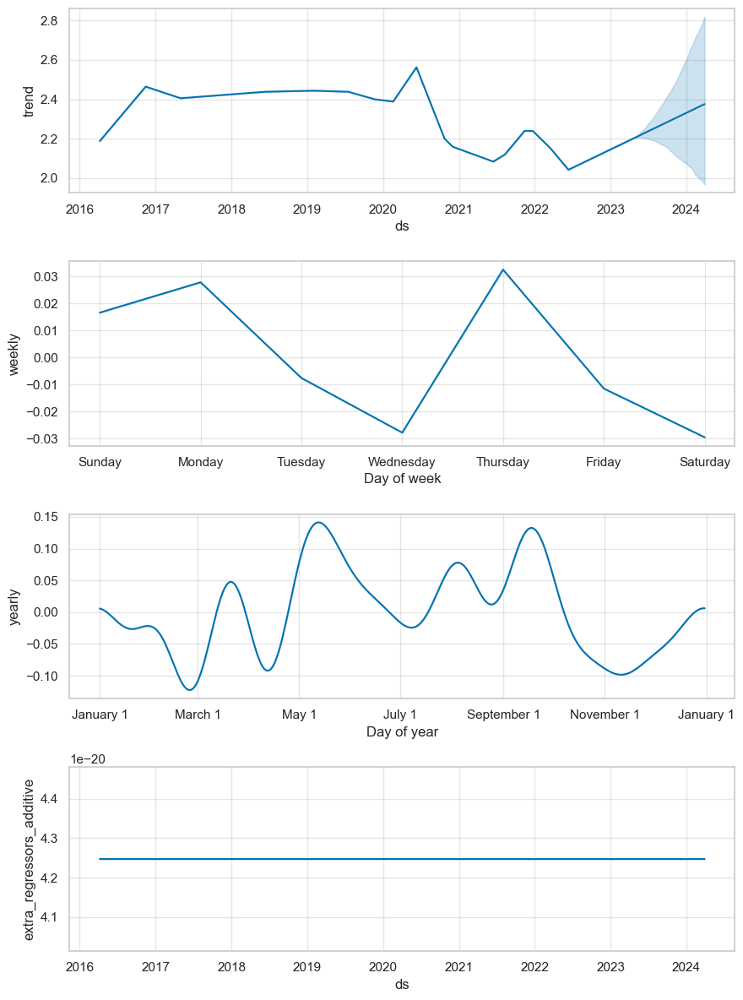

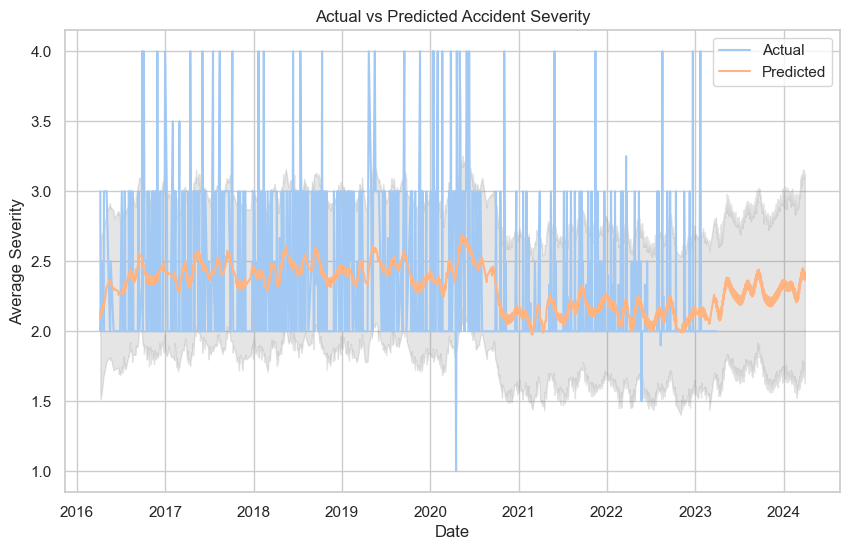

In [36]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA
from prophet import Prophet
import matplotlib.pyplot as plt

# Load the dataset
df = pd.read_csv('SampledUSAccidentsCleaned.csv')

# Step 1: Preprocess and aggregate data
df['Start_Time'] = pd.to_datetime(df['Start_Time'])
df['Start_Date'] = pd.to_datetime(df['Start_Date'])

# Handle non-numeric columns
df['Severity'] = pd.to_numeric(df['Severity'], errors='coerce')
df['Temperature(F)'] = pd.to_numeric(df['Temperature(F)'], errors='coerce')
df['Humidity(%)'] = pd.to_numeric(df['Humidity(%)'], errors='coerce')
df['Pressure(in)'] = pd.to_numeric(df['Pressure(in)'], errors='coerce')
df['Visibility(mi)'] = pd.to_numeric(df['Visibility(mi)'], errors='coerce')

# Drop rows with NaN values
df = df.dropna()

# Aggregating data by daily accident severity per State, City, and Zipcode
location_df = df.groupby([df['Start_Date'], 'State', 'City', 'Zipcode'])['Severity'].mean().reset_index()
location_df.columns = ['Date', 'State', 'City', 'Zipcode', 'Average_Severity']

# Prepare data for Prophet by choosing a specific State, City, and Zipcode
selected_location_df = location_df[(location_df['State'] == 'CA') & 
                                   (location_df['City'] == 'Miami') & 
                                   (location_df['Zipcode'] == '91761')]

# If no data is found for Cherry Hill, switch to state-level aggregation
if selected_location_df.empty:
    # Use the state-level data for New Jersey
    selected_location_df = location_df[location_df['State'] == 'NJ']

# Aggregate the severity by date to get average severity per day across NJ
selected_location_df = selected_location_df.groupby('Date').agg({'Average_Severity': 'mean'}).reset_index()

# Check if there's enough data
if selected_location_df.shape[0] < 2:
    raise ValueError("Not enough data points after aggregating by state.")

# Prepare the data for Prophet
selected_location_df['ds'] = pd.to_datetime(selected_location_df['Date'])
selected_location_df['y'] = selected_location_df['Average_Severity']

# Merge with weather conditions to use as regressors
selected_location_df = pd.merge(selected_location_df, 
                                df[['Start_Date', 'Temperature(F)', 'Humidity(%)', 
                                    'Pressure(in)', 'Visibility(mi)', 'Sunrise_Sunset']], 
                                left_on='ds', right_on='Start_Date', how='left')

# Drop any remaining NaN values after the merge
selected_location_df = selected_location_df.dropna()

# Apply label encoding for categorical columns like 'Sunrise_Sunset'
label_encoder = LabelEncoder()
selected_location_df['Sunrise_Sunset'] = label_encoder.fit_transform(selected_location_df['Sunrise_Sunset'])

# Apply standard scaling
scaler = StandardScaler()
selected_location_df[['Temperature(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)']] = scaler.fit_transform(
    selected_location_df[['Temperature(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)']]
)

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)  # Reduce to 2 components for simplicity
pca_features = pca.fit_transform(selected_location_df[['Temperature(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)']])
selected_location_df['PCA1'] = pca_features[:, 0]
selected_location_df['PCA2'] = pca_features[:, 1]

# Initialize and fit the model
model = Prophet()
model.add_regressor('PCA1')
model.add_regressor('PCA2')
model.add_regressor('Sunrise_Sunset')

# Fit the model
model.fit(selected_location_df[['ds', 'y', 'PCA1', 'PCA2', 'Sunrise_Sunset']])

# Make future predictions (e.g., next 365 days)
future = model.make_future_dataframe(periods=365)
# Add placeholder PCA values for the future dates (adjust as needed)
future['PCA1'] = 0  
future['PCA2'] = 0  
future['Sunrise_Sunset'] = label_encoder.transform(['Day'] * len(future))  # Adjust if you have future sunrise/sunset data

forecast = model.predict(future)

# Plot the forecast
fig1 = model.plot(forecast)
plt.title('Forecast of Average Severity')
plt.xlabel('Date')
plt.ylabel('Average Severity')
plt.show()

# Plot forecast components
fig2 = model.plot_components(forecast)
plt.show()

# Step 6: Compare actual vs predicted severity
plt.figure(figsize=(10, 6))
plt.plot(selected_location_df['ds'], selected_location_df['y'], label='Actual')
plt.plot(forecast['ds'], forecast['yhat'], label='Predicted')
plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color='gray', alpha=0.2)
plt.title('Actual vs Predicted Accident Severity')
plt.xlabel('Date')
plt.ylabel('Average Severity')
plt.legend()
plt.show()


### 1. Forecast of Average Severity
- **X-Axis (Date)**: Ranges from 2016 to 2024, indicating the timeline for the analysis.
- **Y-Axis (Average Severity)**: Displays average severity values, likely on a scale from 0 to around 4.0.
- **Data Series**:
  - **Black Dots**: Represent actual observed values of average severity.
  - **Blue Line**: Indicates the forecasted average severity, showing the predicted trend over time.
  - **Shaded Area**: Represents the confidence interval around the forecast, illustrating the uncertainty in predictions.

### 2. Trend Over Years
- **X-Axis (Years)**: Displays the years from 2016 to 2024.
- **Y-Axis (Average Severity)**: Shows average severity values.
- **Trends**: This plot highlights the overall trend of average severity over the years, helping to identify patterns or changes in severity.

### 3. Average Severity by Day of the Week
- **X-Axis (Days of the Week)**: Ranges from Sunday to Saturday.
- **Y-Axis (Average Severity)**: Displays average severity for each day.
- **Trends**: This plot reveals how average severity varies by day, indicating specific days that may have higher or lower severity.

### 4. Average Severity by Day of the Year
- **X-Axis (Day of the Year)**: Represents each day from January 1 to December 31.
- **Y-Axis (Average Severity)**: Shows average severity across the year.
- **Trends**: This visualization helps identify seasonal patterns or specific days with notable severity levels.

### 5. Actual vs. Predicted Accident Severity
- **X-Axis (Date)**: Covers the timeline from 2016 to 2024.
- **Y-Axis (Average Severity)**: Displays average severity values.
- **Data Series**:
  - **Orange Line**: Represents actual observed average severity values.
  - **Blue Line**: Indicates predicted average severity values from the model.
  - **Shaded Area**: May represent the confidence interval for the predicted values, showing the range of uncertainty.



# ___________________________________________________________________


# Vertical : Location-Based Traffic Pattern Forecasting
### Analysis Type: Time Series Analysis (Neural Networks)
### Model: Long Short-Term Memory (LSTM)



# ___________________________________________________________________


Epoch 1/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - loss: 0.9063 - mae: 0.6603 - val_loss: 0.2336 - val_mae: 0.3800
Epoch 2/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - loss: 0.2706 - mae: 0.3746 - val_loss: 0.2291 - val_mae: 0.3476
Epoch 3/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 2s 966us/step - loss: 0.2562 - mae: 0.3611 - val_loss: 0.2280 - val_mae: 0.3323
Epoch 4/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 2s 966us/step - loss: 0.2450 - mae: 0.3488 - val_loss: 0.2275 - val_mae: 0.3445
Epoch 5/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 2s 964us/step - loss: 0.2351 - mae: 0.3404 - val_loss: 0.2279 - val_mae: 0.3528
Epoch 6/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 2s 971us/step - loss: 0.2358 - mae: 0.3428 - val_loss: 0.2268 - val_mae: 0.3404
Epoch 7/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 2s 956us/step - loss: 0.2299 - mae: 0.3386 - val_loss: 0.2269 - val_mae: 0.3256
Epoch 8/100
2493/2493 ━━━━━━━━━━━━━━━━━━━━ 2s 980us/step - loss: 0.2278 - mae: 0.3366 - val_loss: 0.2261 - val_mae: 0.3368
Epoch 9/100
2493/249

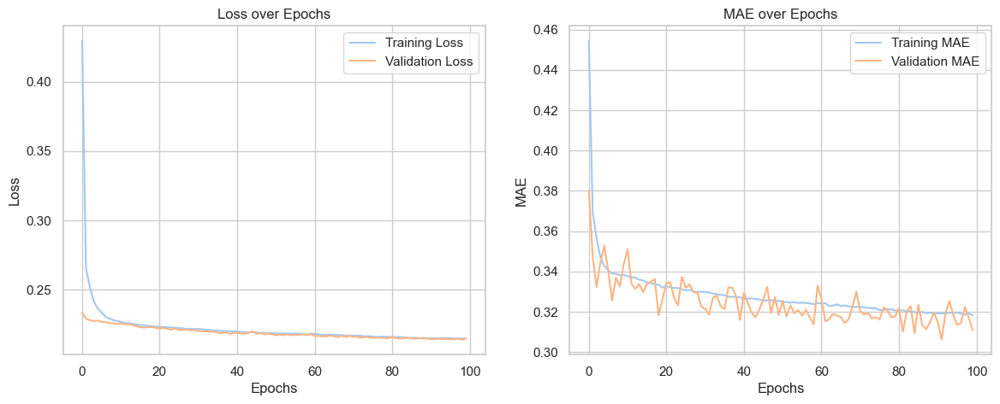

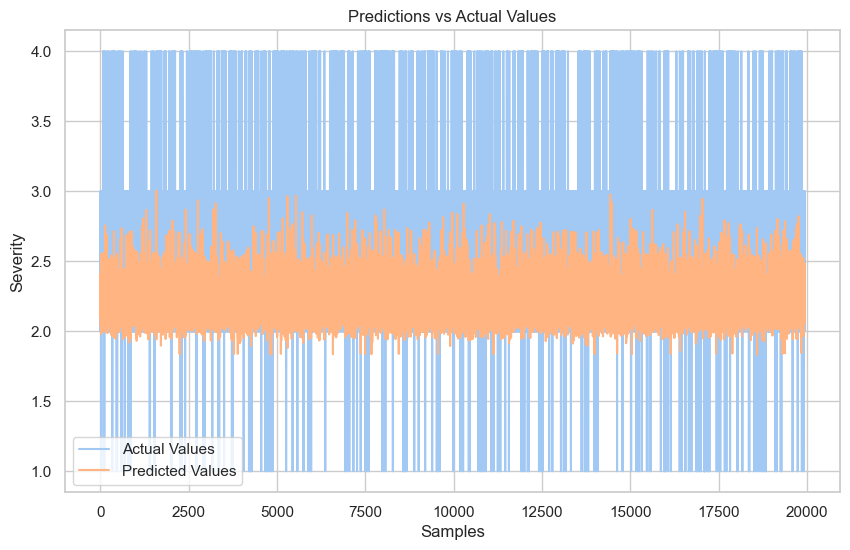

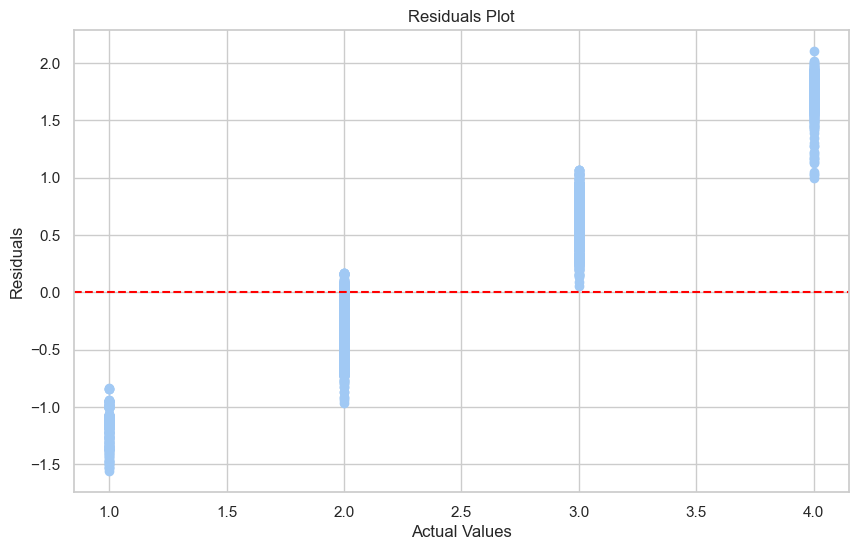

In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam

# Load and preprocess data
df = pd.read_csv('SampledUSAccidentsCleaned.csv')

# Select relevant features for LSTM
features = ['Start_Lat', 'Start_Lng', 'Distance(mi)', 'Sunrise_Sunset', 'Traffic_Signal']
target = 'Severity'

# Label Encoding for categorical features
le_sunrise_sunset = LabelEncoder()
le_traffic_signal = LabelEncoder()

df['Sunrise_Sunset'] = le_sunrise_sunset.fit_transform(df['Sunrise_Sunset'].astype(str))
df['Traffic_Signal'] = le_traffic_signal.fit_transform(df['Traffic_Signal'].astype(str))

# Generate Polynomial Features
poly = PolynomialFeatures(degree=2, interaction_only=False, include_bias=False)
poly_features = poly.fit_transform(df[features])
poly_feature_names = poly.get_feature_names_out(features)

# Create DataFrame with Polynomial Features
df_poly = pd.DataFrame(poly_features, columns=poly_feature_names)

# Combine Polynomial Features with Target Variable
df_final = pd.concat([df_poly, df[target]], axis=1)

# Splitting data into training and testing sets
X = df_final.drop(columns=[target])
y = df_final[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Scaling the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape the input data to 3D for LSTM
X_train_scaled = X_train_scaled.reshape((X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_scaled = X_test_scaled.reshape((X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build LSTM model
model = Sequential()
model.add(LSTM(units=25, return_sequences=True, input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(units=25))
model.add(Dropout(0.2))
model.add(Dense(units=1, activation='linear'))

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=['mae'])

# Train the model
history = model.fit(X_train_scaled, y_train, epochs=100, batch_size=32, validation_data=(X_test_scaled, y_test))

# Evaluate the model
loss, mae = model.evaluate(X_test_scaled, y_test)
print(f"Test MAE: {mae:.2f}")

# Make predictions
y_pred = model.predict(X_test_scaled)

# Sample predictions
for i in range(5):
    print(f"True: {y_test.iloc[i]}, Predicted: {y_pred[i][0]:.2f}")

# Plotting the Loss
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plotting the MAE
plt.subplot(1, 2, 2)
plt.plot(history.history['mae'], label='Training MAE')
plt.plot(history.history['val_mae'], label='Validation MAE')
plt.title('MAE over Epochs')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()

# Plotting Predictions vs Actual Values
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual Values')
plt.plot(y_pred, label='Predicted Values')
plt.title('Predictions vs Actual Values')
plt.xlabel('Samples')
plt.ylabel('Severity')
plt.legend()
plt.show()

# Calculate residuals
residuals = y_test.values - y_pred.flatten()

# Residuals Plot
plt.figure(figsize=(10, 6))
plt.scatter(y_test.values, residuals)
plt.title('Residuals Plot')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.axhline(0, color='red', linestyle='--')
plt.show()


### Training Summary

1. **Epochs**:
   - The model is trained over 100 epochs, with the output showing the results for the first six epochs.
   - Each epoch includes:
     - **Training Steps**: 2493 steps per epoch.
     - **Loss**: The training loss, which decreases over the epochs, indicating improved model performance.
     - **Mean Absolute Error (MAE)**: A metric that also decreases, showing that the model's predictions are getting closer to the actual values.
     - **Validation Loss and MAE**: These metrics are also reported, providing insight into how well the model generalizes to unseen data.

2. **Final Test Metrics**:
   - After training, the model is evaluated on a test set, yielding a test MAE of 0.31.
   - Sample predictions are provided alongside the true values, showing how closely the model's predictions align with the actual values.

### Visualizations

1. **Loss over Epochs**:
   - A plot showing the training and validation loss across epochs.
   - The training loss should ideally decrease over time, indicating that the model is learning.

2. **MAE over Epochs**:
   - A plot displaying the training and validation MAE over epochs.
   - Similar to the loss plot, a decreasing trend in MAE indicates improved model performance.

3. **Predictions vs. Actual Values**:
   - A scatter plot comparing predicted values against actual values.
   - This visualization helps assess how well the model's predictions match the true values, with a closer alignment indicating better performance.

4. **Residuals Plot**:
   - A plot showing the residuals (the difference between actual and predicted values) against the actual values.
   - This plot helps identify any patterns in the residuals, which can indicate model bias or areas where the model may not be performing well.


# ____________________________________________________________________